In [2]:
import pandas as pd
import numpy as np
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt
from scipy.stats import kde
import os

In [2]:
data = pd.read_csv('light_curve_text_files_clean/00020044.txt', delimiter="\t| ", engine='python', names=['time','time +error', 'time -error', 'photon count','PC +error','PC -error'])

data['ln_time']=np.log(data['time'])
data['ln_PC']=np.log(data['photon count'])
data['ln_x+err']=data['time +error']/data['time']
data['ln_x-err']=-data['time -error']/data['time']
data['ln_y+err']=data['PC +error']/data['photon count']
data['ln_y-err']=-data['PC -error']/data['photon count']
data=data.sort_values('ln_time')

x = data['ln_time']
y = data['ln_PC']
x_neg_err = data['ln_x-err']
x_pos_err = data['ln_x+err']
y_neg_err = data['ln_y-err']
y_pos_err = data['ln_y+err']

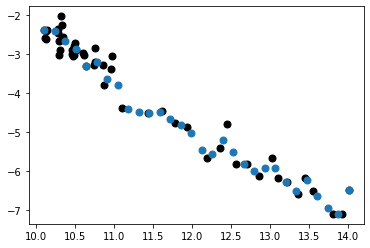

In [3]:
#interpolate
xnew = xnew = np.linspace(min(x), max(x), num=30, endpoint=True)
f2 = interp1d(x, y, kind='linear')
            
                    
plot = plt.figure()
plot = plt.plot(x, y, 'ko', xnew, f2(xnew), 'o', markersize=7)
plot = plt.show()

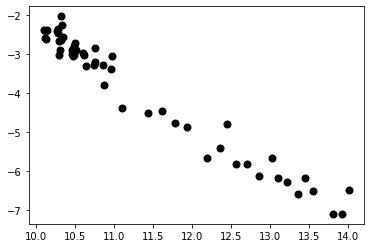

In [4]:
plot2 = plt.figure()
plot2 = plt.plot(x,y, 'ko', markersize=7)

In [5]:
#randomly generate points within the errors for one point
xy_min = [(x[0]-x_neg_err[0]),(y[0]-y_neg_err[0])]
xy_max = [(x[0]+x_pos_err[0]),(y[0]+y_pos_err[0])]
data = np.random.uniform(low=xy_min, high=xy_max, size=(30,2))

In [6]:
x_data = []
for n in range(0,29):
    x_data.append(data[n,0])
    
y_data = []
for n in range(0,29):
    y_data.append(data[n,1])

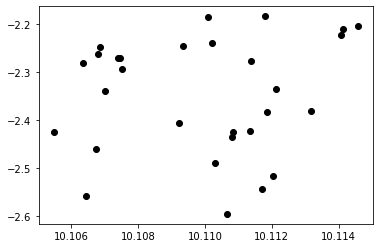

In [7]:
plt.plot(x_data,y_data, 'ko')

In [8]:
#loop over all points
x_data=[]
y_data=[]
for i in range(0,(len(x)-1)):
    xy_min = [(x[i]-x_neg_err[i]),(y[i]-y_neg_err[i])]
    xy_max = [(x[i]+x_pos_err[i]),(y[i]+y_pos_err[i])]
    data = np.random.uniform(low=xy_min, high=xy_max, size=(20,2))
    for n in range(0,19):
        x_data.append(data[n,0])
    
    for n in range(0,19):
        y_data.append(data[n,1])
    
    xy_min2 = [(x[i]-(x_neg_err[i]/1.5)),(y[i]-(y_neg_err[i]/1.5))]
    xy_max2 = [(x[i]+(x_pos_err[i]/1.5)),(y[i]+(y_pos_err[i]/1.5))]
    data2 = np.random.uniform(low=xy_min2, high=xy_max2, size=(20,2))
    for n in range(0,19):
        x_data.append(data2[n,0])
    for n in range(0,19):
        y_data.append(data2[n,1])
        
    xy_min3 = [(x[i]-(x_neg_err[i]/3)),(y[i]-(y_neg_err[i]/3))]
    xy_max3 = [(x[i]+(x_pos_err[i]/3)),(y[i]+(y_pos_err[i]/3))]
    data3 = np.random.uniform(low=xy_min3, high=xy_max3, size=(30,2))
    for n in range(0,29):
        x_data.append(data3[n,0])
    
    for n in range(0,29):
        y_data.append(data3[n,1])
        
    xy_min4 = [(x[i]-(x_neg_err[i]/4)),(y[i]-(y_neg_err[i]/4))]
    xy_max4 = [(x[i]+(x_pos_err[i]/4)),(y[i]+(y_pos_err[i]/4))]
    data4 = np.random.uniform(low=xy_min4, high=xy_max4, size=(20,2))
    for n in range(0,19):
        x_data.append(data4[n,0])
    
    for n in range(0,19):
        y_data.append(data4[n,1])

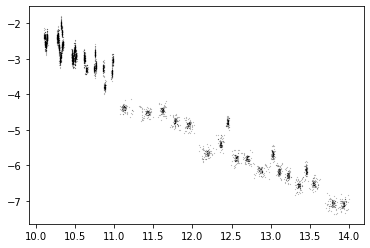

In [9]:
plt.plot(x_data,y_data, 'ko',markersize=0.1)

(array([[ 0.,  0.,  0., ...,  9.,  0.,  0.],
        [ 0.,  0.,  0., ..., 16.,  0.,  0.],
        [ 0.,  0.,  0., ..., 39., 56., 13.],
        ...,
        [ 3., 19., 27., ...,  0.,  0.,  0.],
        [ 6., 14., 18., ...,  0.,  0.,  0.],
        [ 5., 34., 34., ...,  0.,  0.,  0.]]),
 array([10.10538569, 10.20264148, 10.29989727, 10.39715306, 10.49440885,
        10.59166464, 10.68892043, 10.78617622, 10.88343201, 10.9806878 ,
        11.0779436 , 11.17519939, 11.27245518, 11.36971097, 11.46696676,
        11.56422255, 11.66147834, 11.75873413, 11.85598992, 11.95324571,
        12.0505015 , 12.1477573 , 12.24501309, 12.34226888, 12.43952467,
        12.53678046, 12.63403625, 12.73129204, 12.82854783, 12.92580362,
        13.02305941, 13.1203152 , 13.217571  , 13.31482679, 13.41208258,
        13.50933837, 13.60659416, 13.70384995, 13.80110574, 13.89836153,
        13.99561732]),
 array([-7.36880507, -7.22971996, -7.09063485, -6.95154974, -6.81246463,
        -6.67337952, -6.53429441, -

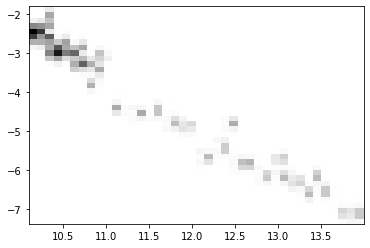

In [10]:
# Evaluate a gaussian kde on a regular grid of nbins x nbins over data extents
nbins=40
k = kde.gaussian_kde([x_data,y_data])
xi, yi = np.mgrid[min(x_data):max(x_data):nbins*1j, min(y_data):max(y_data):nbins*1j]
zi = k(np.vstack([xi.flatten(), yi.flatten()]))
 
# plot a density
#plt.pcolormesh(xi, yi, zi.reshape(xi.shape), cmap='Greys')
plt.hist2d(x_data, y_data, bins=nbins, cmap='binary')



In [11]:
#interpolated points, use average error
x_avg_err = np.mean(x_pos_err)
y_avg_err = np.mean(y_pos_err)

xnew = np.linspace(min(x), max(x), num=50, endpoint=True)
f2 = interp1d(x, y, kind='linear')
ynew = f2(xnew)
xdatanew = []
ydatanew= []

for i in range(0,(len(xnew)-1)):
    xynew_min = [(xnew[i]-x_avg_err),(ynew[i]-y_avg_err)]
    xynew_max = [(xnew[i]+x_avg_err),(ynew[i]+y_avg_err)]
    datanew = np.random.uniform(low=xynew_min, high=xynew_max, size=(20,2))
    for n in range(0,19):
        xdatanew.append(datanew[n,0])
    
    for n in range(0,19):
        ydatanew.append(datanew[n,1])
        
    xynew_min2 = [(xnew[i]-(x_avg_err/1.5)),(ynew[i]-(y_avg_err/1.5))]
    xynew_max2 = [(xnew[i]+(x_avg_err/1.5)),(ynew[i]+(y_avg_err/1.5))]
    datanew2 = np.random.uniform(low=xynew_min2, high=xynew_max2, size=(20,2))
    for n in range(0,19):
        xdatanew.append(datanew2[n,0])
    for n in range(0,19):
        ydatanew.append(datanew2[n,1])
    
        
    xynew_min3 = [(xnew[i]-(x_avg_err/3)),(ynew[i]-(y_avg_err/3))]
    xynew_max3 = [(xnew[i]+(x_avg_err/3)),(ynew[i]+(y_avg_err/3))]
    datanew3 = np.random.uniform(low=xynew_min3, high=xynew_max3, size=(30,2))
    for n in range(0,29):
        xdatanew.append(datanew3[n,0])
    
    for n in range(0,29):
        ydatanew.append(datanew3[n,1])
        
    xynew_min4 = [(xnew[i]-(x_avg_err/4)),(ynew[i]-(y_avg_err/4))]
    xynew_max4 = [(xnew[i]+(x_avg_err/4)),(ynew[i]+(y_avg_err/4))]
    datanew4 = np.random.uniform(low=xynew_min4, high=xynew_max4, size=(20,2))
    for n in range(0,19):
        xdatanew.append(datanew4[n,0])
    
    for n in range(0,19):
        ydatanew.append(datanew4[n,1])

In [12]:
xnew

array([10.10900495, 10.18860076, 10.26819657, 10.34779238, 10.4273882 ,
       10.50698401, 10.58657982, 10.66617563, 10.74577144, 10.82536725,
       10.90496306, 10.98455887, 11.06415468, 11.14375049, 11.2233463 ,
       11.30294211, 11.38253792, 11.46213374, 11.54172955, 11.62132536,
       11.70092117, 11.78051698, 11.86011279, 11.9397086 , 12.01930441,
       12.09890022, 12.17849603, 12.25809184, 12.33768765, 12.41728346,
       12.49687928, 12.57647509, 12.6560709 , 12.73566671, 12.81526252,
       12.89485833, 12.97445414, 13.05404995, 13.13364576, 13.21324157,
       13.29283738, 13.37243319, 13.452029  , 13.53162482, 13.61122063,
       13.69081644, 13.77041225, 13.85000806, 13.92960387, 14.00919968])

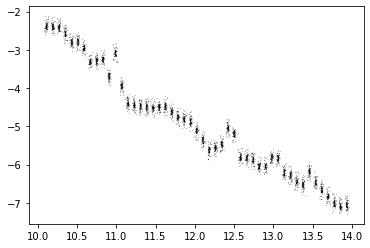

In [13]:
plt.plot(xdatanew,ydatanew, 'ko',markersize=0.1)

(array([[ 0.,  0.,  0., ..., 36., 43., 11.],
        [ 0.,  0.,  0., ..., 79., 48.,  8.],
        [ 0.,  0.,  0., ..., 24., 11.,  3.],
        ...,
        [ 2.,  7., 14., ...,  0.,  0.,  0.],
        [10., 72., 58., ...,  0.,  0.,  0.],
        [12., 40., 35., ...,  0.,  0.,  0.]]),
 array([10.08232334, 10.17916703, 10.27601072, 10.37285442, 10.46969811,
        10.5665418 , 10.6633855 , 10.76022919, 10.85707288, 10.95391658,
        11.05076027, 11.14760396, 11.24444766, 11.34129135, 11.43813504,
        11.53497874, 11.63182243, 11.72866612, 11.82550982, 11.92235351,
        12.01919721, 12.1160409 , 12.21288459, 12.30972829, 12.40657198,
        12.50341567, 12.60025937, 12.69710306, 12.79394675, 12.89079045,
        12.98763414, 13.08447783, 13.18132153, 13.27816522, 13.37500891,
        13.47185261, 13.5686963 , 13.66553999, 13.76238369, 13.85922738,
        13.95607107]),
 array([-7.29193155, -7.16265809, -7.03338463, -6.90411117, -6.77483771,
        -6.64556425, -6.51629079, -

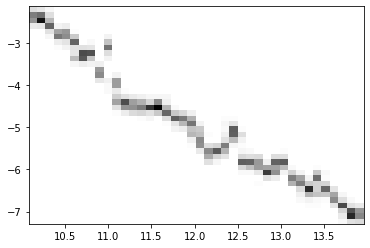

In [14]:
plt.hist2d(xdatanew, ydatanew, bins=nbins, cmap='binary')

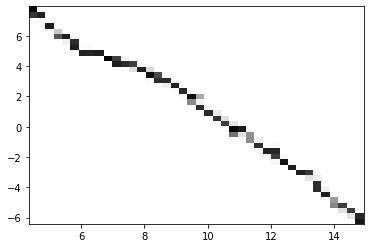

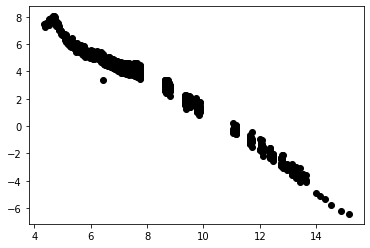

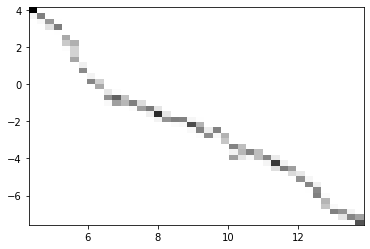

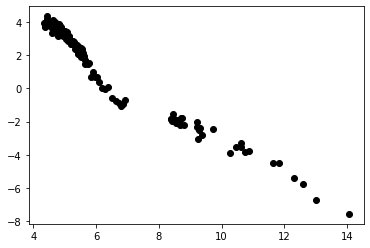

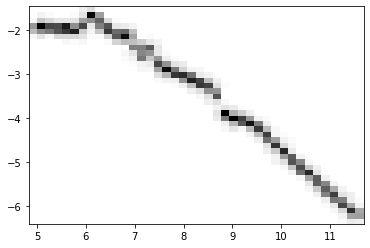

...

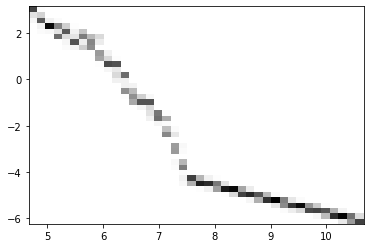

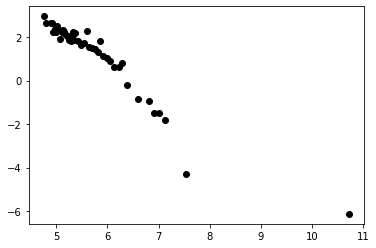

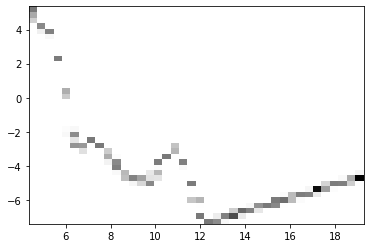

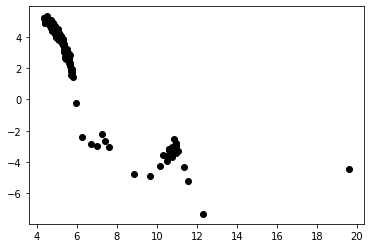

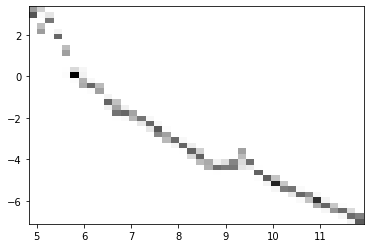

In [15]:
#loop over whole dataset
directory = os.fsencode('light_curve_text_files_clean')

for file in os.listdir(directory):
    filename = os.fsdecode(file)
    
            
    data = pd.read_csv('light_curve_text_files/{0}'.format(filename), delimiter="\t| ", engine='python', names=['time','time +error', 'time -error', 'photon count','PC +error','PC -error'])

    data['ln_time']=np.log(data['time'])
    data['ln_PC']=np.log(data['photon count'])
    data['ln_x+err']=data['time +error']/data['time']
    data['ln_x-err']=-data['time -error']/data['time']
    data['ln_y+err']=data['PC +error']/data['photon count']
    data['ln_y-err']=-data['PC -error']/data['photon count']
    data=data.sort_values('ln_time')
    
    x = data['ln_time']
    y = data['ln_PC']
    x_neg_err = data['ln_x-err']
    x_pos_err = data['ln_x+err']
    y_neg_err = data['ln_y-err']
    y_pos_err = data['ln_y+err']
    
    x_avg_err = np.mean(x_pos_err)
    y_avg_err = np.mean(y_pos_err)
    
    if len(x)>4:

        xnew = np.linspace(min(x), max(x), num=50, endpoint=True)
        f2 = interp1d(x, y, kind='linear')
        ynew = f2(xnew)
        xdatanew = []
        ydatanew= []

        for i in range(0,(len(xnew)-1)):
            xynew_min = [(xnew[i]-x_avg_err),(ynew[i]-y_avg_err)]
            xynew_max = [(xnew[i]+x_avg_err),(ynew[i]+y_avg_err)]
            datanew = np.random.uniform(low=xynew_min, high=xynew_max, size=(20,2))
            for n in range(0,19):
                xdatanew.append(datanew[n,0])

            for n in range(0,19):
                ydatanew.append(datanew[n,1])

            xynew_min2 = [(xnew[i]-(x_avg_err/1.5)),(ynew[i]-(y_avg_err/1.5))]
            xynew_max2 = [(xnew[i]+(x_avg_err/1.5)),(ynew[i]+(y_avg_err/1.5))]
            datanew2 = np.random.uniform(low=xynew_min2, high=xynew_max2, size=(20,2))
            for n in range(0,19):
                xdatanew.append(datanew2[n,0])
            for n in range(0,19):
                ydatanew.append(datanew2[n,1])


            xynew_min3 = [(xnew[i]-(x_avg_err/3)),(ynew[i]-(y_avg_err/3))]
            xynew_max3 = [(xnew[i]+(x_avg_err/3)),(ynew[i]+(y_avg_err/3))]
            datanew3 = np.random.uniform(low=xynew_min3, high=xynew_max3, size=(30,2))
            for n in range(0,29):
                xdatanew.append(datanew3[n,0])

            for n in range(0,29):
                ydatanew.append(datanew3[n,1])

            xynew_min4 = [(xnew[i]-(x_avg_err/4)),(ynew[i]-(y_avg_err/4))]
            xynew_max4 = [(xnew[i]+(x_avg_err/4)),(ynew[i]+(y_avg_err/4))]
            datanew4 = np.random.uniform(low=xynew_min4, high=xynew_max4, size=(20,2))
            for n in range(0,19):
                xdatanew.append(datanew4[n,0])

            for n in range(0,19):
                ydatanew.append(datanew4[n,1])

        plot = plt.figure()
        plot = plt.hist2d(xdatanew, ydatanew, bins=40, cmap='binary')
        plot = plt.show()
        plot2 = plt.figure()
        plot2 = plt.plot(x,y, 'ko')
        plot2 = plt.show()
    

In [353]:
#loop over whole dataset
directory = os.fsencode('light_curve_text_files_clean')

for file in os.listdir(directory):
    filename = os.fsdecode(file)
    
            
    data = pd.read_csv('light_curve_text_files/{0}'.format(filename), delimiter="\t| ", engine='python', names=['time','time +error', 'time -error', 'photon count','PC +error','PC -error'])

    data['ln_time']=np.log(data['time'])
    data['ln_PC']=np.log(data['photon count'])
    data['ln_x+err']=data['time +error']/data['time']
    data['ln_x-err']=-data['time -error']/data['time']
    data['ln_y+err']=data['PC +error']/data['photon count']
    data['ln_y-err']=-data['PC -error']/data['photon count']
    data=data.sort_values('ln_time')
    
    x = data['ln_time']
    y = data['ln_PC']
    x_neg_err = data['ln_x-err']
    x_pos_err = data['ln_x+err']
    y_neg_err = data['ln_y-err']
    y_pos_err = data['ln_y+err']
    
    x_avg_err = np.mean(x_pos_err)
    y_avg_err = np.mean(y_pos_err)
    if len(x)>4:    
        xnew = np.linspace(min(x), max(x), num=50, endpoint=True)
        f2 = interp1d(x, y, kind='linear')
        ynew = f2(xnew)
        xnp = np.array(xnew)
        ynp = np.array(ynew)
        errors = []
        xy_err_min_avg = np.array([(-x_avg_err),(-y_avg_err)])
        xy_err_max_avg = np.array([(x_avg_err),(y_avg_err)])
        for i in range(0, len(xnp)):
            for j in range(1,1000):
                datanew = np.random.uniform(low=(xy_err_min_avg/j), high=(xy_err_max_avg/j), size=(10,2))
                errors.append(datanew)
        xy= np.array(list(zip(xnp,ynp)))
        errors=np.array(errors)
        errors = errors.reshape(50,9990,2)
        data = []
        for i in range(0, len(xnp)):
            data.append(xy[i,]+errors[i,])
        data = np.array(data)
        data = data.reshape(499500,2)
        xfinal, yfinal = zip(*data)
        plot = plt.figure()
        plot = plt.hist2d(xfinal, yfinal, bins=40, cmap='binary')
        plot = plt.axis('off')
        plot = plt.show()
        plot = plt.savefig('final_light_curves/l_{0}.png'.format(filename))
        plot2 = plt.figure()
        plot2 = plt.plot(xfinal,yfinal, 'ko',markersize=0.1)
        plot2 = plt.show()

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

<Figure size 432x288 with 0 Axes>

KeyboardInterrupt: 

In [ ]:
#loop over whole dataset using less for loops, faster
directory = os.fsencode('light_curve_text_files_clean')

for file in os.listdir(directory):
    filename = os.fsdecode(file)
    
            
    data = pd.read_csv('light_curve_text_files/{0}'.format(filename), delimiter="\t| ", engine='python', names=['time','time +error', 'time -error', 'photon count','PC +error','PC -error'])

    data['ln_time']=np.log(data['time'])
    data['ln_PC']=np.log(data['photon count'])
    data['ln_x+err']=data['time +error']/data['time']
    data['ln_x-err']=-data['time -error']/data['time']
    data['ln_y+err']=data['PC +error']/data['photon count']
    data['ln_y-err']=-data['PC -error']/data['photon count']
    data=data.sort_values('ln_time')
    
    x = data['ln_time']
    y = data['ln_PC']
    x_neg_err = data['ln_x-err']
    x_pos_err = data['ln_x+err']
    y_neg_err = data['ln_y-err']
    y_pos_err = data['ln_y+err']
    
    x_avg_err = np.mean(x_pos_err)
    y_avg_err = np.mean(y_pos_err)
    if len(x)>4:    
        xnew = np.linspace(min(x), max(x), num=50, endpoint=True)
        f2 = interp1d(x, y, kind='linear')
        ynew = f2(xnew)
        xnp = np.array(xnew)
        ynp = np.array(ynew)
        errors = []
        xy_err_min_avg = np.array([(-x_avg_err),(-y_avg_err)])
        xy_err_max_avg = np.array([(x_avg_err),(y_avg_err)])
        for i in range(0, len(xnp)):
            for j in range(1,1000):
                datanew = np.random.uniform(low=(xy_err_min_avg/j), high=(xy_err_max_avg/j), size=(10,2))
                errors.append(datanew)
        xy= np.array(list(zip(xnp,ynp)))
        errors=np.array(errors)
        errors = errors.reshape(50,9990,2)
        data = []
        for i in range(0, len(xnp)):
            data.append(xy[i,]+errors[i,])
        data = np.array(data)
        data = data.reshape(499500,2)
        xfinal, yfinal = zip(*data)
        plot = plt.figure()
        plot = plt.hist2d(xfinal, yfinal, bins=40, cmap='binary')
        plot = plt.axis('off')
        plot = plt.show()
        plot = plt.savefig('final_light_curves/l_{0}.png'.format(filename))
        plot2 = plt.figure()
        plot2 = plt.plot(xfinal,yfinal, 'ko',markersize=0.1)
        plot2 = plt.show()

In [13]:
#loop over whole dataset using less for loops, faster
directory = os.fsencode('light_curve_text_files_clean')

for file in os.listdir(directory):
    filename = os.fsdecode(file)
    
            
    data = pd.read_csv('light_curve_text_files/{0}'.format(filename), delimiter="\t| ", engine='python', names=['time','time +error', 'time -error', 'photon count','PC +error','PC -error'])

    data['ln_time']=np.log(data['time'])
    data['ln_PC']=np.log(data['photon count'])
    data['ln_x+err']=data['time +error']/data['time']
    data['ln_x-err']=-data['time -error']/data['time']
    data['ln_y+err']=data['PC +error']/data['photon count']
    data['ln_y-err']=-data['PC -error']/data['photon count']
    data=data.sort_values('ln_time')
    
    x = data['ln_time']
    y = data['ln_PC']
    x_neg_err = data['ln_x-err']
    x_pos_err = data['ln_x+err']
    y_neg_err = data['ln_y-err']
    y_pos_err = data['ln_y+err']
    
    x_avg_err = np.median(x_pos_err)
    y_avg_err = np.median(y_pos_err)
    if len(x)>4:    
        xnew = np.linspace(min(x), max(x), num=50, endpoint=True)
        f2 = interp1d(x, y, kind='linear')
        ynew = f2(xnew)
        xnp = np.array(xnew)
        ynp = np.array(ynew)
        
        xpoints = []
        ypoints = []
        for i in range(len(xnp)):
            xpoints.append(np.random.normal(loc=xnp[i],scale=x_avg_err, size=(10000)))
            ypoints.append(np.random.normal(loc=ynp[i],scale=y_avg_err, size=(10000)))
        xpoints = np.array(xpoints)
        ypoints = np.array(ypoints)
        xpoints=xpoints.reshape(500000)
        ypoints=ypoints.reshape(500000)                          
        plot = plt.figure()
        plot = plt.hist2d(xpoints, ypoints, bins=40, cmap='binary')
        plot = plt.axis('off')
        #plot = plt.show()
        plot = plt.savefig('final_light_curves_2/l_{0}.png'.format(filename))

/Users/cashaanderson/opt/anaconda3/envs/tf/lib/python3.7/site-packages/ipykernel_launcher.py:43: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
